In [1]:
%load_ext autoreload
%autoreload 2

from argparse import ArgumentParser

import cv2
import h5py
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import torch
import torch.nn.functional as F
import umap

from torch.utils.data import DataLoader, random_split
from torchvision import transforms
from tqdm.notebook import tqdm
from pytorch_lightning.loggers import TensorBoardLogger

from data_utils import Center0Dataset, calculate_stats, OneCenterLoad
from augmentations import basic_augmentations, color_augmentations, no_augmentations
from model import Classifier

In [2]:
# data_dir = '/home/haicu/sophia.wagner/datasets/2101_camelyon17/'
data_dir = '/storage/groups/haicu/datasets/2101_camelyon17/patches/'
%time data = OneCenterLoad(data_dir, 0, 'train', transform=None)
# %time basic_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
# %time color_aug = Center0Dataset(data_file, 'train', transform=color_augmentations)

CPU times: user 7.98 s, sys: 24.7 s, total: 32.7 s
Wall time: 54.5 s


In [3]:
mean = torch.Tensor([0.6710, 0.5327, 0.6448])
std = torch.Tensor([0.2083, 0.2294, 0.1771])

In [27]:
torch.manual_seed(0)
rows, columns, img_size = 2, 8, 2
indices = torch.randint(len(data), (rows * columns, ))
print(indices)

tensor([12620,  8535, 11909,  7464,  8107, 17115, 12499, 13975,  4945, 17115,
         9797,  6986,  4740, 14175, 10270, 12920])


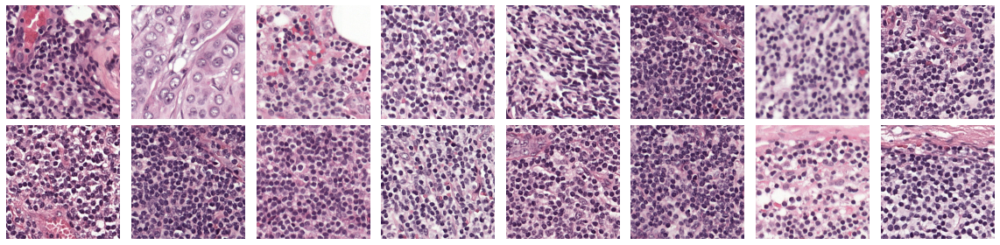

In [12]:
# %time no_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
plt.figure(figsize=(columns * img_size, rows * img_size))
for i in range(rows * columns):
    img = no_aug[indices[1]][0]
    img = img * std[ :, None, None] + mean[ :, None, None]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()
# del no_aug

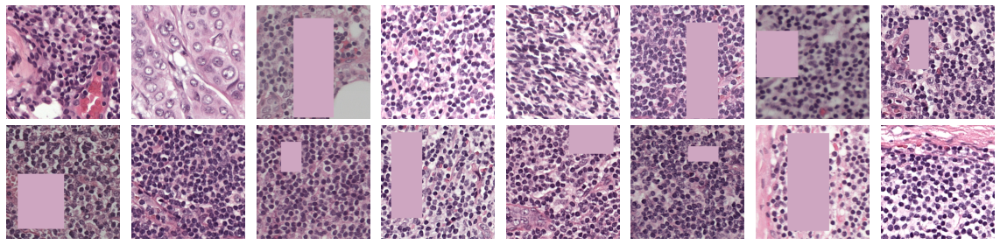

In [5]:
# %time basic_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
plt.figure(figsize=(columns * img_size, rows * img_size))
for i in range(rows * columns):
    img = basic_aug[indices[i]][0]
    img = img * std[ :, None, None] + mean[ :, None, None]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()
# del basic_aug

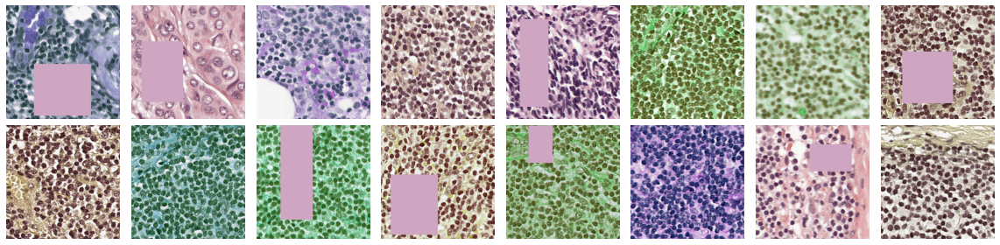

In [9]:
# %time color_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
plt.figure(figsize=(columns * img_size, rows * img_size))
for i in range(rows * columns):
    img = color_aug[indices[i]][0]
    img = img * std[ :, None, None] + mean[ :, None, None]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()
# del color_aug

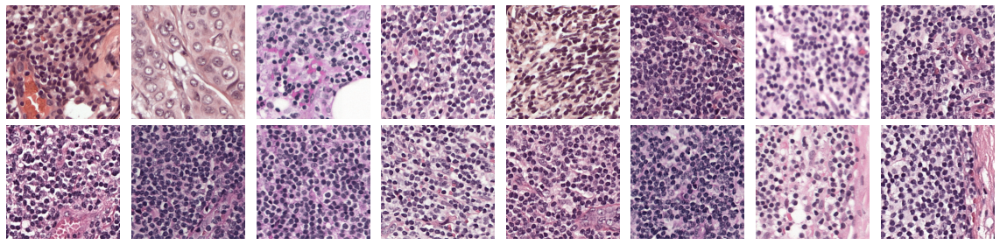

In [13]:
# %time color_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    RandomRotate90([0, 90, 180, 270]),
    transforms.RandomApply((transforms.GaussianBlur(3), ), p=0.25),
    transforms.RandomApply((transforms.ColorJitter(brightness=0.1, contrast=0.1), ), p=0.5),
    transforms.RandomApply((transforms.ColorJitter(saturation=0.1, hue=0.1), ), p=0.5),
])

plt.figure(figsize=(columns * img_size, rows * img_size))
for i in range(rows * columns):
    img = data.data['patches'][indices[i]]
    img = transform(img)

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()
# del color_aug

In [24]:
img = data.data['patches'][19343] # 19343

In [8]:
import random 
class RandomRotate90:
    def __init__(self, angles):
        self.angles = angles

    def __call__(self, x):
        angle = random.choice(self.angles)
        return transforms.functional.rotate(x, angle)

6537
22601
16283
24944


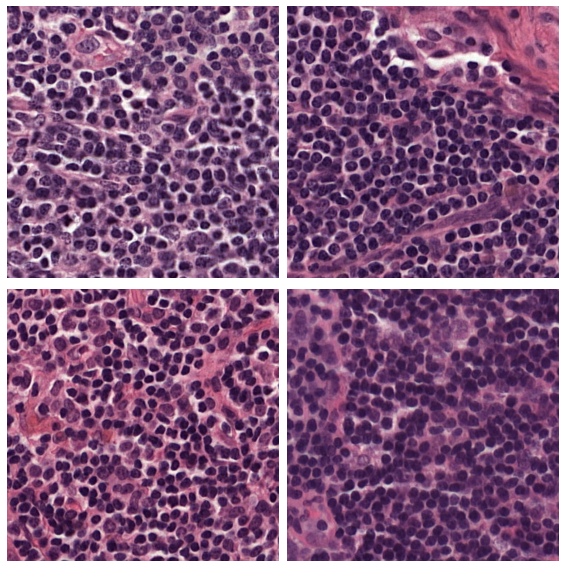

In [8]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 2, 2, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
#     aug = transform(img)
    idx = torch.randint(len(data), (1,)).item()
    print(idx)
    img = data.data['patches'][idx]
    aug = img

    plt.subplot(rows, columns, i + 1)
    plt.imshow(aug.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()


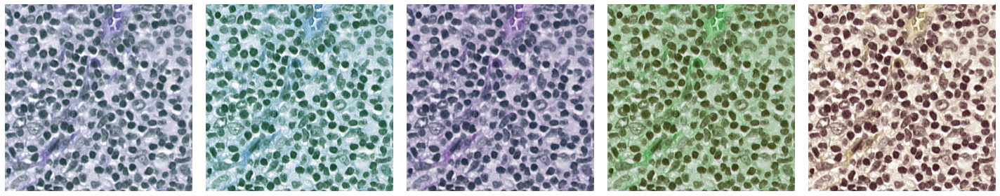

In [28]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
    transforms.RandomApply((transforms.GaussianBlur(3), ), p=0.25),
    transforms.RandomApply((transforms.ColorJitter(brightness=0.1, contrast=0.1), ), p=1.),
    transforms.RandomApply((transforms.ColorJitter(saturation=0.5, hue=0.5), ), p=1.),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)

    plt.subplot(rows, columns, i + 1)
    plt.imshow(aug.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

In [9]:
# options for the model, default arguments + commandline arguments
class Args:
    concat = 1
    crop_size = 216 # only used as an argument for training
    dis_norm = None
    dis_scale = 3
    dis_spectral_norm = False
    dataroot ='data'
    gpu = 0
    input_dim = 3
    isDcontent = False
    nThreads = 4
    num_domains = 5
    nz = 8
    resume = '/home/haicu/sophia.wagner/projects/stain_color/stain_aug/mdmm_model.pth'
opts = Args()

from mdmm.model import MD_multi

# model
print('--- load model ---')
model = MD_multi(opts)
model.resume(opts.resume, train=False)
model.eval(); # remove ; to output architecture of the network

--- load model ---


In [10]:
            mean_domains = torch.Tensor([
                [ 0.3020, -2.6476, -0.9849, -0.7820, -0.2746,  0.3361,  0.1694, -1.2148],
                [ 0.1453, -1.2400, -0.9484,  0.9697, -2.0775,  0.7676, -0.5224, -0.2945],
                [ 2.1067, -1.8572,  0.0055,  1.2214, -2.9363,  2.0249, -0.4593, -0.9771],
                [ 0.8378, -2.1174, -0.6531,  0.2986, -1.3629, -0.1237, -0.3486, -1.0716],
                [ 1.6073,  1.9633, -0.3130, -1.9242, -0.9673,  2.4990, -2.2023, -1.4109],
            ])

            std_domains = torch.Tensor([
                [0.6550, 1.5427, 0.5444, 0.7254, 0.6701, 1.0214, 0.6245, 0.6886],
                [0.4143, 0.6543, 0.5891, 0.4592, 0.8944, 0.7046, 0.4441, 0.3668],
                [0.5576, 0.7634, 0.7875, 0.5220, 0.7943, 0.8918, 0.6000, 0.5018],
                [0.4157, 0.4104, 0.5158, 0.3498, 0.2365, 0.3612, 0.3375, 0.4214],
                [0.6154, 0.3440, 0.7032, 0.6220, 0.4496, 0.6488, 0.4886, 0.2989],
            ])

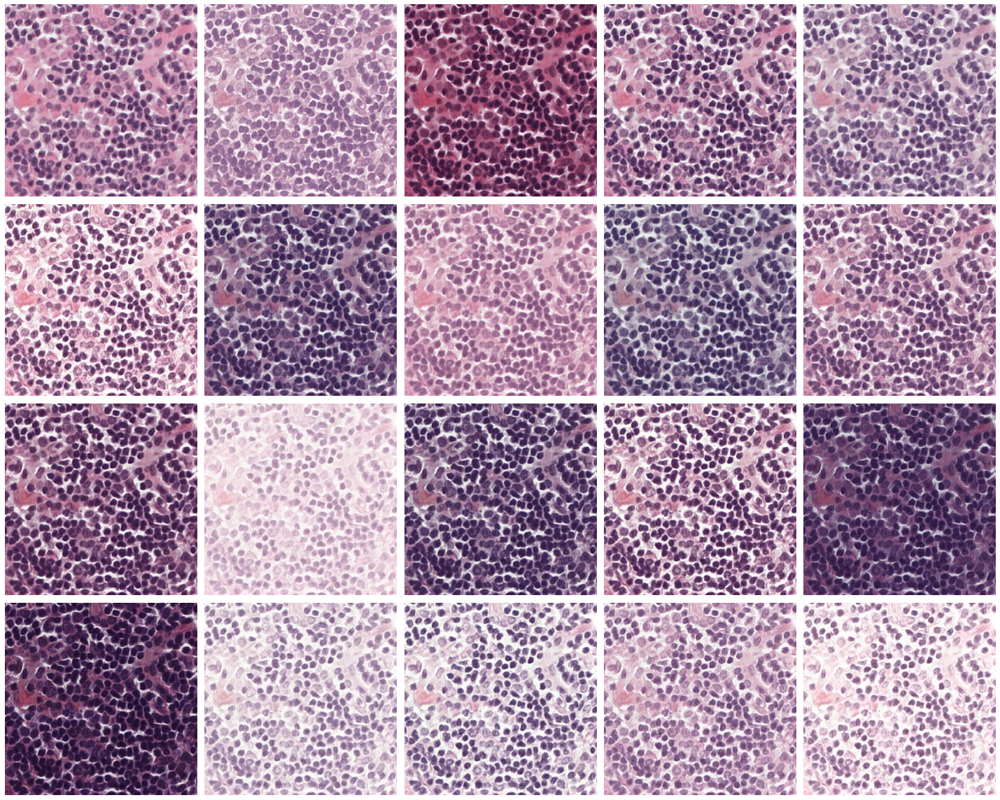

In [14]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 4, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
img = data.data['patches'][16283]
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)
    new_domain = torch.ones((1,)).long() * 0
#     new_domain = torch.randint(5, (1,))
    z_attr = torch.randn((1, 8, )) * 2 * std_domains[new_domain] + mean_domains[new_domain]
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]


    plt.subplot(rows, columns, i + 1)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

tensor([[0.7500, 0.0000, 0.2500, 0.0000, 0.0000]])
tensor([[0.5000, 0.0000, 0.5000, 0.0000, 0.0000]])
tensor([[0.2500, 0.0000, 0.7500, 0.0000, 0.0000]])
tensor([[0., 0., 1., 0., 0.]])


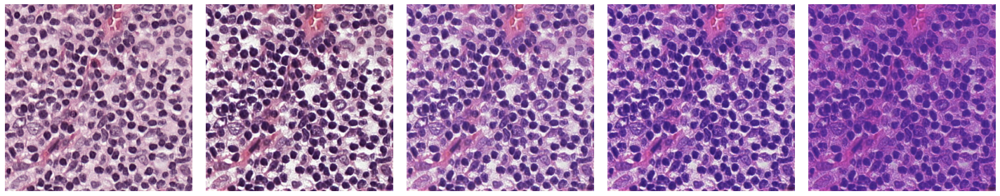

In [23]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
plt.subplot(rows, columns, 1)    
plt.axis('off')
img = data.data['patches'][19343]
plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns -1):
    aug = transform(img)
    z_attr_a = torch.randn((1, 8, )) * std_domains[0] + mean_domains[0]
    z_attr_b = torch.randn((1, 8, )) * std_domains[2] + mean_domains[2]

#     z_attr = model.enc_a.forward(img, img_domain)
#     z_attr = model.enc_a.forward(aug.sub(0.5).mul(2), torch.eye(5)[0])
#     domain_a = torch.eye(5)[0]
#     domain_a[0] -= 0.2 * (i+1)
#     domain_b = torch.zeros(5)
#     domain_b[2] += 0.2 * (i+1)
#     z_attr = ((1 - 0.2 * (i+1)) * mean_domains[0] + (0.2 * (i+1)) * mean_domains[2]).unsqueeze(0)
    z_attr = ((1 - 0.25 * (i+1)) * z_attr_a + (0.25 * (i+1)) * z_attr_b)
#     print(z_attr_a.shape, z_attr.shape)

    domain = ((1 - 0.25 * (i+1)) * torch.eye(5)[0] + (0.25 * (i+1)) * torch.eye(5)[2]).unsqueeze(0)
    print(domain)
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]


    plt.subplot(rows, columns, i + 2)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

In [152]:
torch.eye(5)[0].unsqueeze(0).shape

torch.Size([1, 5])

tensor([10035])
tensor([16314])
tensor([20215])
tensor([1585])
tensor([4050])
tensor([18204])


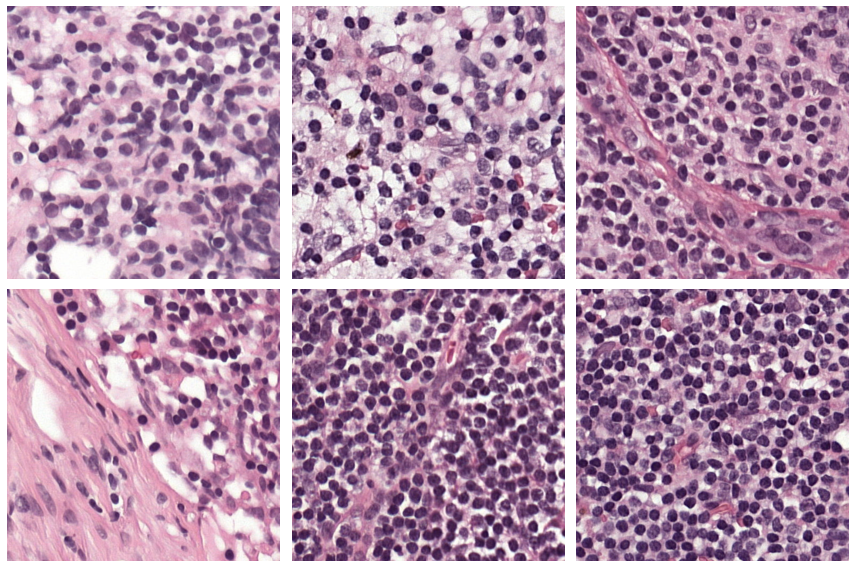

In [29]:
rows, columns, img_size = 2, 3, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
plt.axis('off')
for i in range(rows * columns):
#     aug = transform(img)
    idx = torch.randint(len(data), (1, ))
    img = data.data['patches'][idx][0]
    print(idx)

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

## Prepare data for Melanie for quantitative evaluation

### Camleyon data

In [10]:
plot = [1, 2]
save_indices = list(range(100))
random.shuffle(save_indices)

–––––––– center 0 –––––––
26 original 2 augmented 1
47 original 2 augmented 1
4 original 1 augmented 2
77 original 1 augmented 2
–––––––– center 1 –––––––
7 original 1 augmented 2
25 original 2 augmented 1
0 original 1 augmented 2
56 original 2 augmented 1
–––––––– center 2 –––––––
98 original 2 augmented 1
53 original 2 augmented 1
91 original 1 augmented 2
69 original 2 augmented 1
–––––––– center 3 –––––––
18 original 2 augmented 1
78 original 2 augmented 1
75 original 2 augmented 1
14 original 2 augmented 1
–––––––– center 4 –––––––
60 original 1 augmented 2
3 original 1 augmented 2
82 original 1 augmented 2
17 original 1 augmented 2


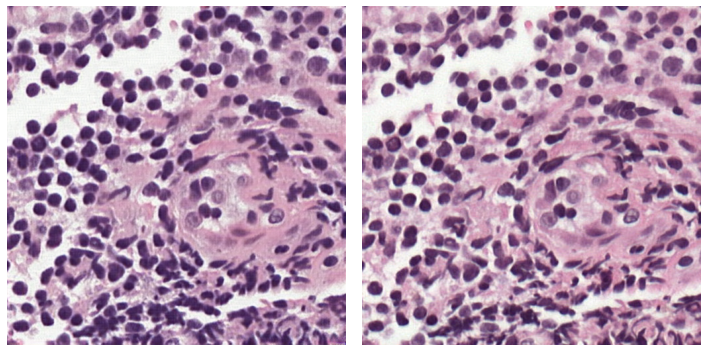

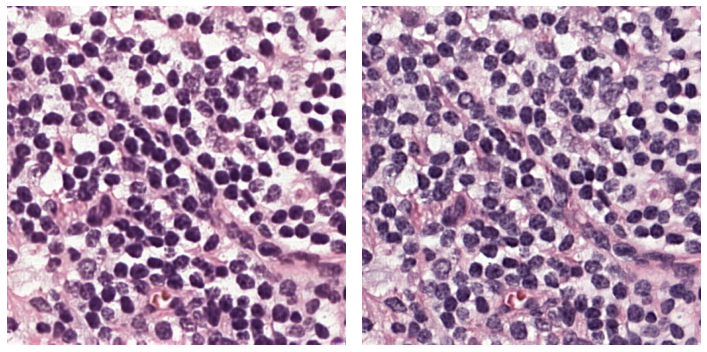

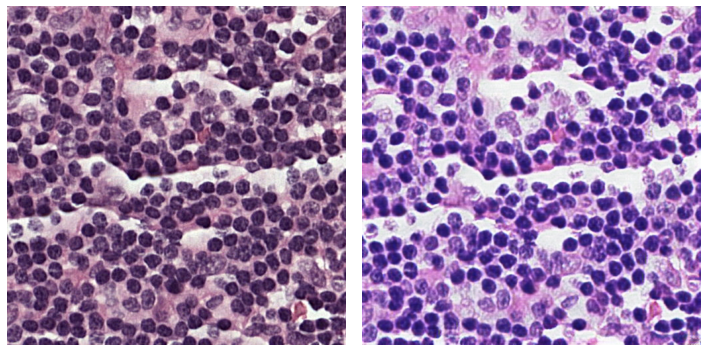

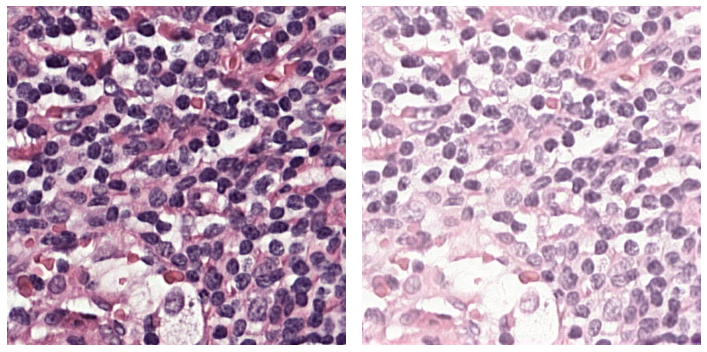

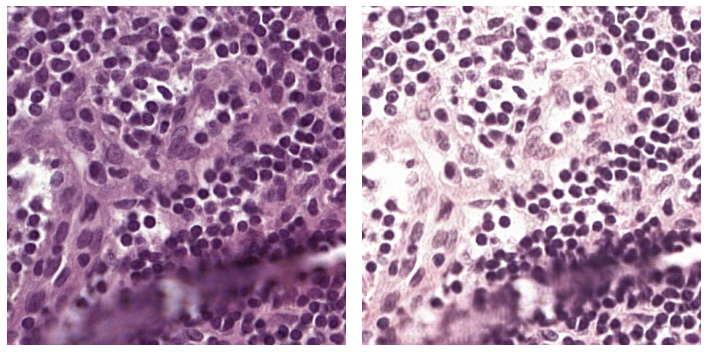

...

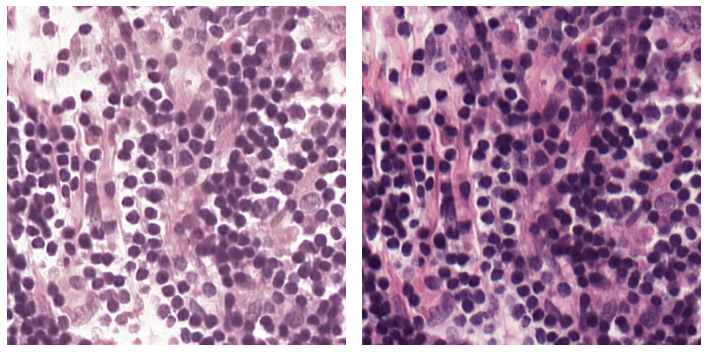

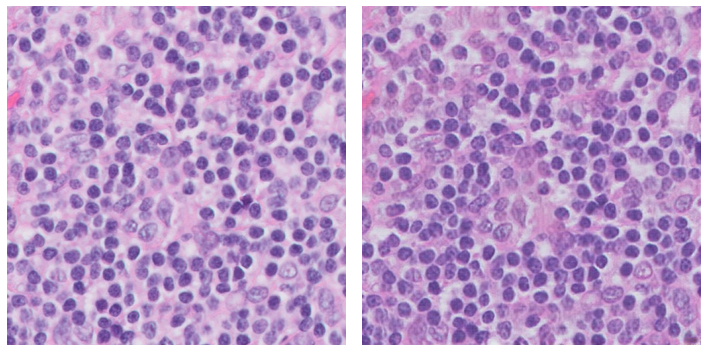

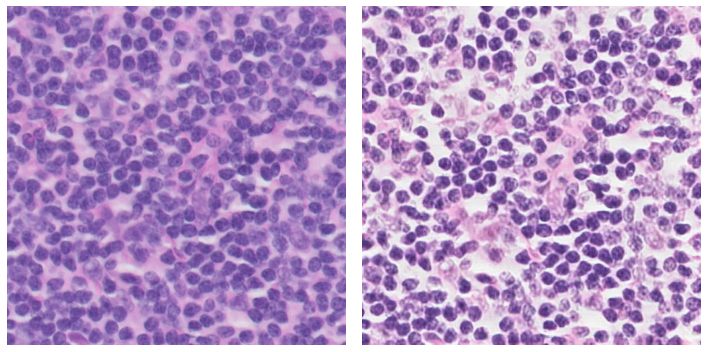

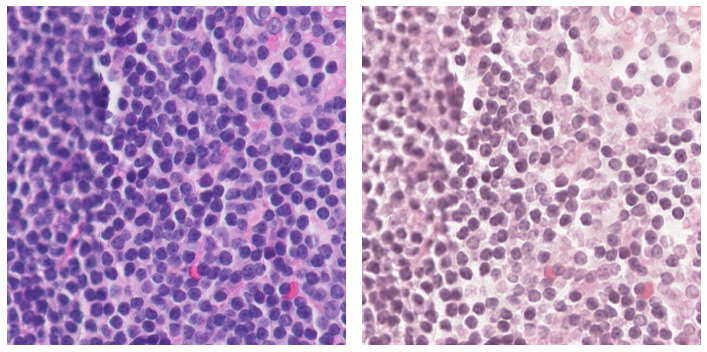

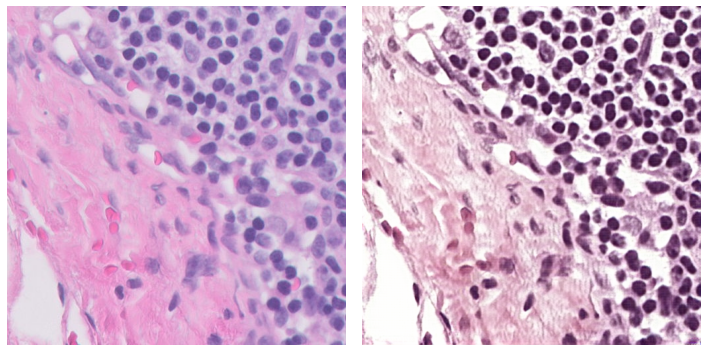

In [47]:
save_dir = '/home/haicu/sophia.wagner/projects/stain_color/stain_aug/tiles_for_melanie/lymphnodes/'
data_dir = '/home/haicu/sophia.wagner/datasets/2101_camelyon17/'
for c in range(5):
    print(f'–––––––– center {c} –––––––')
    data = OneCenterLoad(data_dir, c, 'train', transform=None)
    for i in range(4):
        random.shuffle(plot)
        print(save_indices[c*5 + i], 'original', plot[0], 'augmented', plot[1])
        index = torch.randint(0, len(data), (1,))

        rows, columns, img_size = 1, 2, 5
        plt.figure(figsize=(columns * img_size, rows * img_size))

        plt.subplot(rows, columns, plot[0])   
        img = data.data['patches'][index][0]
        plt.imshow(img.permute(1, 2, 0))
        plt.axis('off')

        aug = img
        new_domain = torch.randint(5, (1, ))
        z_attr = torch.randn((1, 8, )) #* std_domains[new_domain] + mean_domains[new_domain])
        domain = torch.eye(5)[new_domain]
        z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
        out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

        plt.subplot(rows, columns, plot[1])
        plt.imshow(out.add(1).div(2).permute(1, 2, 0))
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(save_dir + f'{save_indices[c*5 + i]}.png')

### CRC patches Heidelberg

In [108]:
plot = [1, 2]
save_indices = list(range(100))
random.shuffle(save_indices)

In [110]:
save_dir = '/home/haicu/sophia.wagner/projects/stain_color/stain_aug/tiles_for_melanie/CRC_heidelberg/'
for c, c_name in enumerate(['LYM', 'MUS', 'NORM', 'STR', 'TUM']):
    print(f'–––––––– center {c_name} –––––––')
    tile_dir = f'/storage/groups/haicu/datasets/201120_CRC_patches_Heidelberg/CRC-VAL-HE-7K/{c_name}/'
    tiles = os.listdir(tile_dir)
    for i in range(8):
        index = torch.randint(0, len(tiles), (1,))
        random.shuffle(plot)
        print(save_indices[c*8 + i], 'original', plot[0], 'augmented', plot[1])
#         print(index.item(), 'original', plot[0], 'augmented', plot[1])

        rows, columns, img_size = 1, 2, 5
        plt.figure(figsize=(columns * img_size, rows * img_size))

        plt.subplot(rows, columns, plot[0])   
        img = cv2.imread(tile_dir + tiles[index])
        plt.imshow(img)
        plt.axis('off')
        
        aug = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float() / 255.
#         aug = F.interpolate(img, size=256, mode='bilinear')
        new_domain = torch.randint(5, (1, ))
        z_attr = torch.randn((1, 8, )) #* std_domains[new_domain] + mean_domains[new_domain])
        domain = torch.eye(5)[new_domain]
        z_content = model.enc_c(aug.sub(0.5).mul(2))
        out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

        plt.subplot(rows, columns, plot[1])
        plt.imshow(out.add(1).div(2).permute(1, 2, 0))
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(save_dir + f'{save_indices[c*8 + i]}.png')
        plt.close()

–––––––– center LYM –––––––
11 original 1 augmented 2
14 original 2 augmented 1
70 original 1 augmented 2
41 original 2 augmented 1
99 original 2 augmented 1
91 original 2 augmented 1
87 original 1 augmented 2
6 original 1 augmented 2
–––––––– center MUS –––––––
92 original 1 augmented 2
50 original 2 augmented 1
79 original 2 augmented 1
4 original 1 augmented 2
16 original 2 augmented 1
7 original 1 augmented 2
38 original 1 augmented 2
69 original 2 augmented 1
–––––––– center NORM –––––––
13 original 2 augmented 1
36 original 1 augmented 2
63 original 2 augmented 1
44 original 1 augmented 2
76 original 2 augmented 1
12 original 1 augmented 2
55 original 2 augmented 1
56 original 1 augmented 2
–––––––– center STR –––––––
74 original 1 augmented 2
21 original 2 augmented 1
82 original 1 augmented 2
85 original 1 augmented 2
65 original 2 augmented 1
43 original 2 augmented 1
71 original 2 augmented 1
37 original 1 augmented 2
–––––––– center TUM –––––––
61 original 2 augmented 1
93 o

### TUPAC breast cancer

In [196]:
plot = [1, 2]
image_dir = '/home/haicu/sophia.wagner/projects/stain_color/mdmm_model/data/'

In [200]:
img = cv2.imread(image_dir + '10.png')

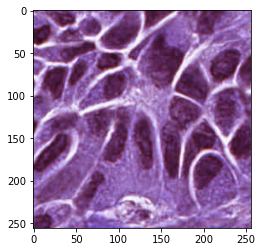

In [203]:
plt.imshow(img[:256, :256])

In [204]:
img.shape

(1000, 1000, 3)

In [ ]:
save_dir = '/home/haicu/sophia.wagner/projects/stain_color/stain_aug/tiles_for_melanie/breast/'
# for c, c_name in enumerate(['LYM', 'MUS', 'NORM', 'STR', 'TUM']):
#     print(f'–––––––– center {c_name} –––––––')
tiles = os.listdir(image_dir)
for i, tile in enumerate(tiles):
    random.shuffle(plot)
    print(tile, 'original', plot[0], 'augmented', plot[1])
#         print(index.item(), 'original', plot[0], 'augmented', plot[1])

    rows, columns, img_size = 1, 2, 5
    plt.figure(figsize=(columns * img_size, rows * img_size))

    plt.subplot(rows, columns, plot[0])   
    img = cv2.imread(image_dir + tile)
    plt.imshow(img)
    plt.axis('off')

    aug = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float() / 255.
#     aug = F.interpolate(aug, size=512, mode='bilinear')
    new_domain = torch.randint(5, (1, ))
    z_attr = torch.randn((1, 8, )) #* std_domains[new_domain] + mean_domains[new_domain])
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

    plt.subplot(rows, columns, plot[1])
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(save_dir + tile)
    plt.close()

18.png original 1 augmented 2
27.png original 2 augmented 1
4.png original 2 augmented 1
12.png original 2 augmented 1
22.png original 2 augmented 1
2.png original 2 augmented 1
1.png original 2 augmented 1
17.png original 1 augmented 2
20.png original 2 augmented 1
9.png original 2 augmented 1
23.png original 1 augmented 2
14.png original 2 augmented 1
26.png original 2 augmented 1
19.png original 2 augmented 1
21.png original 2 augmented 1
5.png original 2 augmented 1
13.png original 1 augmented 2
15.png original 2 augmented 1


In [3]:
data_dir = '/home/haicu/sophia.wagner/datasets/2101_camelyon17/'
data = {
    'patches': []
}
with h5py.File(data_dir + 'center3_level2.hdf5', 'r') as h5_file:
    # Walk through all groups, extracting datasets
    for gname, group in h5_file.items():
        data['patches'].append(torch.from_numpy(group['patches'][:]))
        break
#                 self.data['tumor_ratio'].append(torch.from_numpy(group['tumor_ratio'][:]))


In [4]:
data['patches'] = torch.cat(data['patches']).permute(0, 3, 1, 2)

In [5]:
img = data['patches'][100]

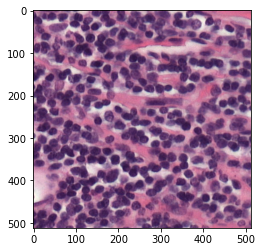

In [6]:
plt.imshow(img.permute(1, 2, 0))

## Clustering

In [51]:
# takes 6 mins and loads all patches from the 5 camelyon centers with size 128x128
data_dir = '/home/haicu/sophia.wagner/datasets/2101_camelyon17/'
data_sets = []
for c in tqdm(range(5)):
    data = OneCenterLoad(data_dir, c, 'train', transform=None)
    patches = data.data['patches']
    mask = torch.randint(10, (len(patches), )).bool() # mdmm augmentations are applied with probability 0.5
    patches = F.interpolate(patches[~mask], size=64)
    data_sets.append(patches)
    del data

In [52]:
labels = [torch.ones(len(item))*i for i, item in enumerate(data_sets)]
labels = torch.cat(labels)
tensors = torch.cat(data_sets, dim=0).reshape(len(labels), -1)

In [53]:
n_nghb = 100      # in {2, ..., 200}, default 15
min_dst = 0.   # in [0.0, 0.99], default 0.1
reducer = umap.UMAP(n_neighbors=n_nghb, min_dist=min_dst) # took 1h 49min
%time u = reducer.fit_transform(tensors)

CPU times: user 2min 36s, sys: 6.42 s, total: 2min 42s
Wall time: 2min 10s


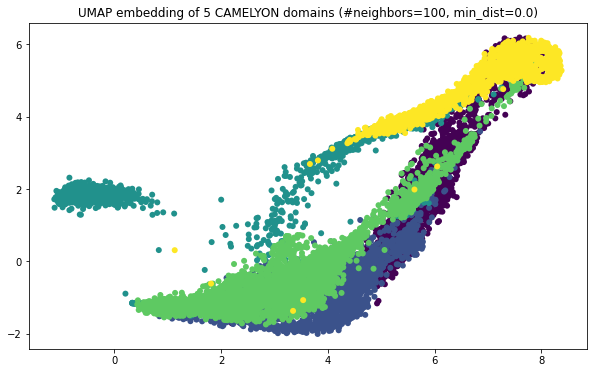

In [54]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6), facecolor=(0., 0., 0., 0.))
plt.scatter(u[:,0], u[:,1], c=labels, edgecolors='none')
plt.title(f'UMAP embedding of 5 CAMELYON domains (#neighbors={n_nghb}, min_dist={min_dst})');
plt.show()

In [ ]:
from sklearn.manifold import TSNE
import plotly.express as px

tsne = TSNE(n_components=3, random_state=0)
%time projections = tsne.fit_transform(tensors, )

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=labels, labels={'color': 'species'}
)
fig.update_traces(marker_size=8)
fig.show()

In [5]:
indices = [[17445, 19343], [15177, 6123], [8891, 17706], [32619, 10908], [16065, 1940]]

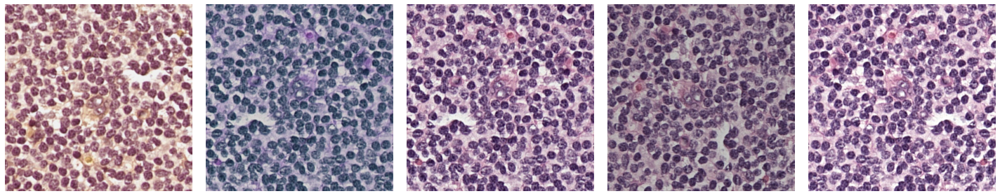

In [23]:
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    RandomRotate90([0, 90, 180, 270]),
    transforms.RandomApply((transforms.GaussianBlur(3), ), p=0.25),
    transforms.RandomApply((transforms.ColorJitter(brightness=0.2, contrast=0.2), ), p=1.),
    transforms.RandomApply((transforms.ColorJitter(saturation=0.3, hue=0.3), ), p=0.5),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    img = data[indices[0][0]][0]
    aug = transform(img)

    plt.subplot(rows, columns, i + 1)
    plt.imshow(aug.permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

### For supplementary material of MICCAI21

In [53]:
domain = 4
# data_dir = '/home/haicu/sophia.wagner/datasets/2101_camelyon17/'
data_dir = '/storage/groups/haicu/datasets/2101_camelyon17/patches/'
%time data = OneCenterLoad(data_dir, domain, 'train', transform=None)

CPU times: user 13 s, sys: 59.7 s, total: 1min 12s
Wall time: 1min 32s


In [54]:
# torch.manual_seed(0)
rows, columns, img_size = 5, 6, 2
indices = torch.randint(len(data), (rows * columns, ))
indices[0] = 31677
indices[1] = 25596
indices[2] = 24502
print(indices)


tensor([31677, 25596, 24502, 26589,  8384, 20054, 12295, 26803, 10995,  6406,
        21799, 20005,  6373, 29502, 10071,  2217, 31817, 15495,  1580, 31069,
        26108, 26562,  6102, 24889,  5962,  8580, 33619,  8732, 17976, 20916])


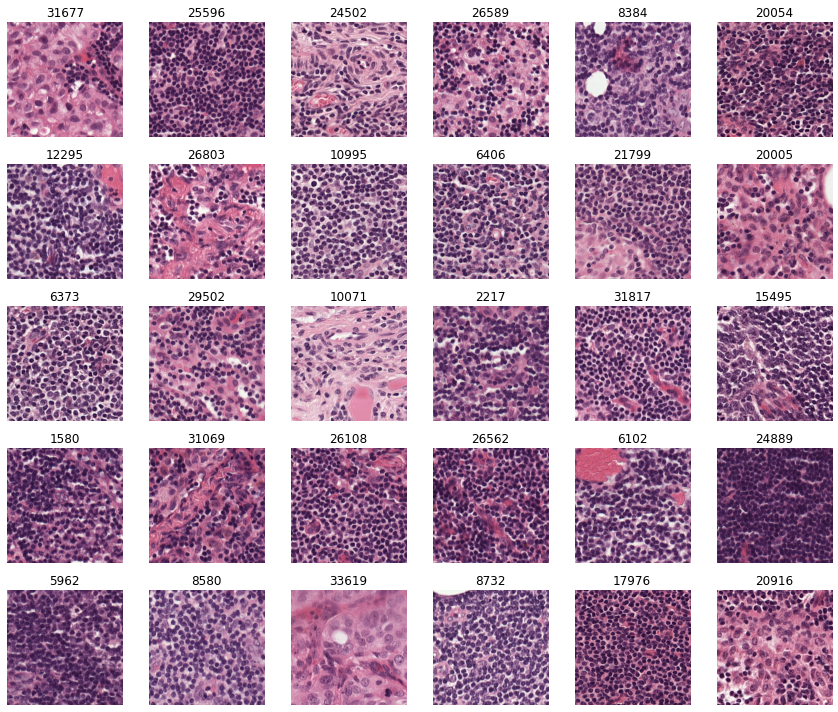

In [55]:
# %time no_aug = Center0Dataset(data_file, 'train', transform=basic_augmentations)
plt.figure(figsize=(columns * img_size, rows * img_size))
for i in range(rows * columns):
    img = data[indices[i]][0]
#     img = img * std[ :, None, None] + mean[ :, None, None]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(img.permute(1, 2, 0))
    plt.title(str(indices[i].item()))
    plt.axis('off')
plt.tight_layout()
# del no_aug

In [9]:
# options for the model, default arguments + commandline arguments
class Args:
    concat = 1
    crop_size = 216 # only used as an argument for training
    dis_norm = None
    dis_scale = 3
    dis_spectral_norm = False
    dataroot ='data'
    gpu = 0
    input_dim = 3
    isDcontent = False
    nThreads = 4
    num_domains = 5
    nz = 8
    resume = '/home/haicu/sophia.wagner/projects/stain_color/stain_aug/mdmm_model.pth'
opts = Args()

from mdmm.model import MD_multi

# model
print('--- load model ---')
model = MD_multi(opts)
model.resume(opts.resume, train=False)
model.eval(); # remove ; to output architecture of the network

--- load model ---


In [10]:
mean_domains = torch.Tensor([
    [ 0.3020, -2.6476, -0.9849, -0.7820, -0.2746,  0.3361,  0.1694, -1.2148],
    [ 0.1453, -1.2400, -0.9484,  0.9697, -2.0775,  0.7676, -0.5224, -0.2945],
    [ 2.1067, -1.8572,  0.0055,  1.2214, -2.9363,  2.0249, -0.4593, -0.9771],
    [ 0.8378, -2.1174, -0.6531,  0.2986, -1.3629, -0.1237, -0.3486, -1.0716],
    [ 1.6073,  1.9633, -0.3130, -1.9242, -0.9673,  2.4990, -2.2023, -1.4109],
])

std_domains = torch.Tensor([
    [0.6550, 1.5427, 0.5444, 0.7254, 0.6701, 1.0214, 0.6245, 0.6886],
    [0.4143, 0.6543, 0.5891, 0.4592, 0.8944, 0.7046, 0.4441, 0.3668],
    [0.5576, 0.7634, 0.7875, 0.5220, 0.7943, 0.8918, 0.6000, 0.5018],
    [0.4157, 0.4104, 0.5158, 0.3498, 0.2365, 0.3612, 0.3375, 0.4214],
    [0.6154, 0.3440, 0.7032, 0.6220, 0.4496, 0.6488, 0.4886, 0.2989],
])

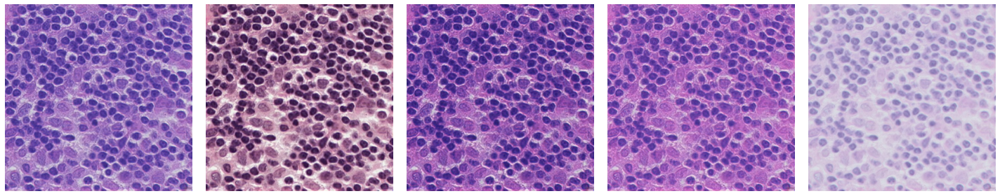

In [12]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
img = data.data['patches'][11631]
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)
#     new_domain = torch.ones((1,)).long() 
    new_domain = torch.randint(5, (1,))
    z_attr = torch.randn((1, 8, )) * 2 * std_domains[new_domain] + mean_domains[new_domain]
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

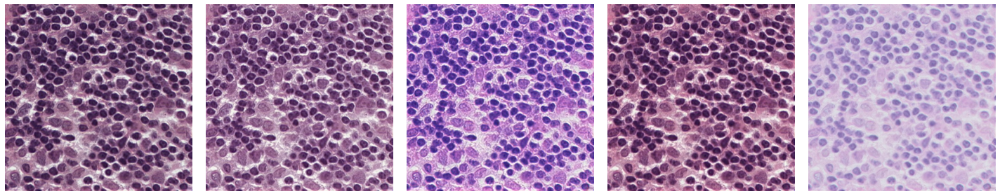

In [13]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
img = data.data['patches'][11631]
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)
    new_domain = torch.ones((1,)).long() * i
#     new_domain = torch.randint(5, (1,))
    z_attr = torch.randn((1, 8, )) * std_domains[new_domain] + mean_domains[new_domain]
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

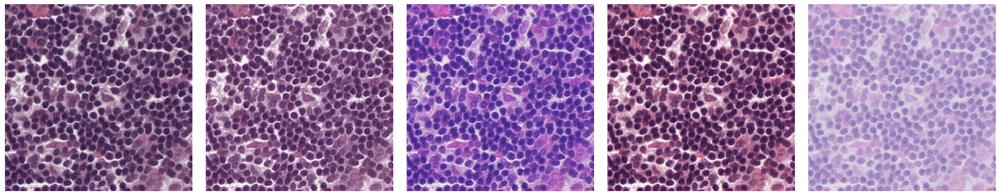

In [56]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
img = data.data['patches'][25596]
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)
    new_domain = torch.ones((1,)).long() * i
#     new_domain = torch.randint(5, (1,))
    z_attr = torch.randn((1, 8, )) * std_domains[new_domain] + mean_domains[new_domain]
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

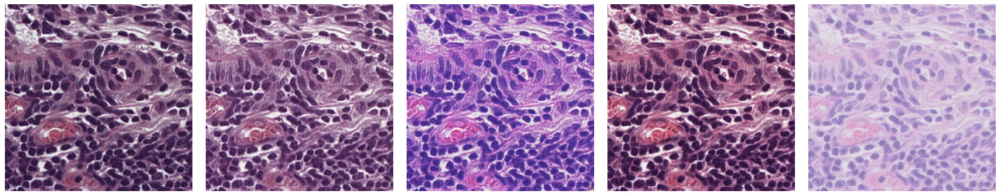

In [57]:
transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     RandomRotate90([0, 90, 180, 270]),
])

rows, columns, img_size = 1, 5, 4
plt.figure(figsize=(columns * img_size, rows * img_size))
# plt.subplot(rows, columns, 1)    
# plt.axis('off')
img = data.data['patches'][24502]
# plt.imshow(img.permute(1, 2, 0))
for i in range(rows * columns):
    aug = transform(img)
    new_domain = torch.ones((1,)).long() * i
#     new_domain = torch.randint(5, (1,))
    z_attr = torch.randn((1, 8, )) * std_domains[new_domain] + mean_domains[new_domain]
    domain = torch.eye(5)[new_domain]
    z_content = model.enc_c(aug.sub(0.5).mul(2).unsqueeze(0))
    out = model.gen(z_content, z_attr, domain).detach().squeeze(0) # in range [-1, 1]

    plt.subplot(rows, columns, i + 1)
    plt.imshow(out.add(1).div(2).permute(1, 2, 0))
    plt.axis('off')
plt.tight_layout()

In [56]:
save_indices = [
    [8327, 4270, 17628, 7810, 15018], 
    [12919, 20602, 701, 2680, 8708], 
    [4194, 1951, 14011, 7596, 8779],
    [31677, 25596, 24502, 10995, 12295],
    [11631, 17868, 14810, 6264, 9876],  # domain E/4
]

In [57]:
for i in range(len(save_indices[domain])):
    img = data[save_indices[domain][i]][0]
    
    torch.save(img, f'sample_tiles/domain_{domain}_{save_indices[domain][i]}.pt')
    

In [15]:
os.getcwd()

'/mnt/home/icb/sophia.wagner/projects/stain_color/stain_aug'

In [21]:
chr(65)

'A'

In [26]:
save_indices[4][1]

17868